<a href="https://colab.research.google.com/github/talitamicheleti/google-places-nearbysearch/blob/master/factSheet_overlayedData_col10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Basic packages

In [ ]:
# importing packages
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# packages to handle shapefiles
import geopandas as gpd
import matplotlib as mpl


# Dictionary of variables
Here, are specified territory names, colors, classes values, etc.

In [ ]:
# dictionary to consider data by state
states = {
    12	: 'Acre',
    27	: 'Alagoas',
    16	: 'Amapá',
    13	: 'Amazonas',
    29	: 'Bahia',
    23	: 'Ceará',
    53	: 'Distrito Federal',
    32	: 'Espírito Santo',
    52	: 'Goiás',
    21	: 'Maranhão',
    51	: 'Mato Grosso',
    50	: 'Mato Grosso do Sul',
    31	: 'Minas Gerais',
    15	: 'Pará',
    25	: 'Paraíba',
    41	: 'Paraná',
    26	: 'Pernambuco',
    22	: 'Piauí',
    24	: 'Rio Grande do Norte',
    43	: 'Rio Grande do Sul',
    33	: 'Rio de Janeiro',
    11	: 'Rondônia',
    14	: 'Roraima',
    42	: 'Santa Catarina',
    35	: 'São Paulo',
    28	: 'Sergipe',
    17	: 'Tocantins'
}

# dictionary of biomas
bioma = {
    1: 'Amazônia',
    2: 'Mata Atlântica',
    3: 'Pantanal',
    4: 'Cerrado',
    5: 'Caatinga',
    6: 'Pampa'
}

# dict decliv
slope = {
    4: 'Até 10%',
    3: 'Entre 10 e 20%',
    2: 'Entre 20 e 30%',
    1: 'Maior que 30%'
}

# hand dict
hand = {
    3: 'Até 3m',
    2: 'Entre 3 e 6m',
    1: 'Maior que 6m'
}

# slum dict
favela = {
    1: 'É favela',
    2: 'Não é favela'
}

# urban perimeter
urbPerim = {
    1: 'Dentro do perímetro urbano',
    2: 'Fora do perímetro urbano'
}

# risk
risk = {
    2: 'Não é área de risco',
    1: 'É área de risco'
}

# intra - urban classes
urban = {
  0: 'Outras classes',
  1: 'Vegetação intraurbana',
  2: 'Fragmentos de vegetação',
  3: 'Área urbana sem vegetação',
  4: 'Água em área urbanizada'
}

# colors dictionary
colorsDict = {
    # 'slope':  {
    #     slope[4]: '#d9ef8b',  # Até 10% — light green
    #     slope[3]: '#a6d96a',  # Entre 10 e 20%
    #     slope[2]: '#66bd63',  # Entre 20 e 30%
    #     slope[1]: '#1a9850',  # Maior que 30% — dark green
    # },
    'slope':  {
        slope[4]: '#7fbc41',  # Até 10% — light green
        slope[3]: '#fec44f',  # Entre 10 e 20%
        slope[2]: '#f1b6da',  # Entre 20 e 30%
        slope[1]: '#c51b7d',  # Maior que 30% — dark green
    },
    'hand': {
        hand[3]: '#c7e9b4',  # Até 3m — light
        hand[2]: '#7fcdbb',  # Entre 3 e 6m
        hand[1]: '#1d91c0',  # Maior que 6m — deeper color
    },
    'slums': {
        favela[1]: '#d73027',  # É favela
        favela[2]: '#cccccc',  # Não é favela
    },
    'urbanPerim': {
        urbPerim[1]: '#377eb8',  # Dentro do perímetro urbano — blue
        urbPerim[2]: '#984ea3',  # Fora do perímetro urbano — purple
    },
    'risk': {
        risk[2]: '#1a9641',  # É área de risco — red
        risk[1]: '#e31a1c',  # Não é área de risco — green
    },
    'vegurb': {
        urban[0]: '#999999',  # Outras classes
        urban[1]: '#9bbfa1',  # Vegetação intraurbana
        urban[2]: '#6c8770',  # Fragmentos de vegetação
        urban[3]: '#ff6666',  # Área urbana sem vegetação
    },
}

#
subdict = {
    'slope': slope,
    'hand': hand,
    'slums': favela,
    'urbanPerim': urbPerim,
    'risk': risk,
    'vegurb': urban,
}

dictTitles = {
    'slope': 'Área urbanizada por faixas de declividade',
    'hand': 'Área urbanizada por proximidade vertical a drenagens',
    'slums': 'Crescimento de favelas no Brasil',
    'urbanPerim': 'Áreas urbanizadas por tipos de setores censitários',
    'risk': 'Áreas urbanizadas em poligonais de áreas de risco',
    'vegurb': 'Vegetação intraurbana',
}

dictGroupBy ={
    'state': {'name': 'Estado', 'values': states},
    'bioma': {'name': 'Bioma', 'values': bioma}
}

# -----------------------------
simplifiedClasses = {
    1: 'Áreas naturais',
    2: 'Agropecuária',
    3: 'Áreas não vegetadas',
    4: 'Áreas urbanas',
    5: 'Água',
    6: 'Não observado'
}

simplifiedPalette = {
  simplifiedClasses[1]: "#1f8d49",
  simplifiedClasses[2]: "#ffefc3",
  simplifiedClasses[3]: "#d4271e",
  simplifiedClasses[4]: "#ffffff",
  simplifiedClasses[5]: "#a6bddb",
  simplifiedClasses[6]: "#d9d9d9",
}

nameByDecade = {
      '1985 to 1995': 'De 1985\n a 1995',
      '1995 to 2005': 'De 1995\n a 2005',
      '2005 to 2015': 'De 2005\n a 2015',
      '2015 to 2024': 'De 2015\n a 2024',
}

# dict to save images (charts)
figureDict = {}

#Layouts for presenting the results
we created this section to standardized layouts presented in the factsheet. they are numbered and described below.

In [ ]:
# additional packages
import matplotlib.image as mpimg
from matplotlib.gridspec import GridSpec
import textwrap
import numpy as np

# additional package
from PIL import Image, ImageDraw, ImageFont

# Preparing the .CSV files to be make it available as .parquet
statistics of the results were calculted using google earth engine. the resulting files were exported as .csv. here, we combined them to make it available as .parquet based on a github repository. the commented code below doesn't need to be run.

In [ ]:
# mounting the google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# files paths
mainPath = '/content/drive/MyDrive/mapbiomas/modurpy/col10/'
figPath = 'images/'
figFolder = mainPath + figPath

# list of figures (to be populated as the results are calculated)
figureList = []
highlightsList = []

In [ ]:
# # reading csv files
# main = '/content/drive/MyDrive/mapbiomas/modurpy/col10/'
# version = 2
# subfolder = 'dados_overlayed'
# folder_path = main + subfolder + "_v" + str(version)
# csv_files = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

# dfs = []
# for filename in csv_files:
#     file_path = os.path.join(folder_path, filename)
#     df = pd.read_csv(file_path)
#     dfs.append(df)

# merged_df = pd.concat(dfs, ignore_index=True).drop(columns=['system:index', '.geo'])
# display(merged_df.head())

# # Export to Parquet (compressed and efficient)
# output_path = folder_path + f'/merged_mapbiomas_col10_v{str(version)}.parquet'
# merged_df.to_parquet(output_path, index=False, compression='snappy')

# print('done')

In [ ]:
# # reading csv files - transitions
# main = '/content/drive/MyDrive/mapbiomas/modurpy/col10/'
# version = 2
# subfolder = 'transitions'
# folder_path = main + subfolder + "_v" + str(version)
# csv_files = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

# dfs = []
# for filename in csv_files:
#     file_path = os.path.join(folder_path, filename)
#     df = pd.read_csv(file_path)
#     dfs.append(df)

# transitions_df = pd.concat(dfs, ignore_index=True).drop(columns=['system:index', '.geo'])

# # setting the column of transitions
# transitions_df['interval'] = transitions_df['y_from'].astype(str) + ' to ' + transitions_df['y_to'].astype(str)

# # class as str to get the digits
# transitions_df['class'] = transitions_df['class'].astype(str)

# # separating the classes (from and to)
# transitions_df['fromClass'] = transitions_df['class'].str[0].astype(int)
# transitions_df['toClass'] = transitions_df['class'].str[1].astype(int)

# # removing extra columns
# transitions_df = transitions_df.drop(columns=['class', 'y_from', 'y_to', 'toClass'])

# # transitions_df = transitions_df[transitions_df['class']=='4']
# display(transitions_df.head())

# # # Export to Parquet (compressed and efficient)
# # output_path = folder_path + f'/transitions_mapbiomas_col10_v{str(version)}.parquet'
# # transitions_df.to_parquet(output_path, index=False, compression='snappy')

# print('done')

In [ ]:
# reading the file of vegurb - file stored on the github
url = 'https://github.com/edimilson-rodrigues/urbanAreasMapping/raw/refs/heads/main/col10/merged_mapbiomas_col10_v2.parquet'
merged_df = pd.read_parquet(url)
display(merged_df.head())

,area,bioma,class,territory,year
0,0.962,1,312121,1100015,2005
1,6.826,1,312123,1100015,2005
2,0.437,1,312223,1100015,2005
3,0.437,1,322121,1100015,2005
4,2.801,1,322123,1100015,2005


In [ ]:
# reading the file of transitions - file stores on the github
url = 'https://github.com/edimilson-rodrigues/urbanAreasMapping/raw/refs/heads/main/col10/transitions_mapbiomas_col10_v2.parquet'
transitions_df = pd.read_parquet(url)
display(transitions_df.head())

,area,bioma,territory,interval,fromClass
0,3.324664,1,1100015,1985 to 1995,1
1,0.700124,1,1100015,1985 to 1995,2
2,116.817140,1,1100015,1985 to 1995,3
3,259.023540,1,1100015,1985 to 1995,4
4,6.784617,1,1100023,1985 to 1995,1


#Transitions - Urbanization on natural and agricultural areas

Overall results based on simplified classes.

##Obtaining transitions areas (overall)

In [ ]:
# obtaining the transitions and aggregating it for the entire brazilain territory
transitions_agg = (
    transitions_df.groupby(['interval', 'fromClass'], as_index=False)
    .agg({'area': 'sum'})
)

# adjusting the resulting dataframe and dropping the columns of 'areas urbanas'.
transitions_agg = transitions_agg.pivot(index='interval', columns='fromClass', values='area').reset_index()\
.rename(columns=simplifiedClasses).drop(columns='Áreas urbanas')

# renaming the intervals adequatelly
transitions_agg['interval'] = transitions_agg['interval'].map(nameByDecade)

# getting the total of area (will be used later)
colsToSum = transitions_agg.columns.drop(['interval'])
transitions_agg['total'] = transitions_agg[colsToSum].sum(axis=1)

# results
display(transitions_agg.head())

fromClass,interval,Áreas naturais,Agropecuária,Áreas não vegetadas,Água,Não observado,total
0,De 1985\n a 1995,138628.455325,524825.124812,105788.152129,5334.744092,157.941331,774734.417688
1,De 1995\n a 2005,131297.279265,504690.127021,49684.982901,6104.715823,81.028952,691858.133962
2,De 2005\n a 2015,106962.495262,515633.425272,43261.564442,4935.159602,43.658790,670836.303369
3,De 2015\n a 2024,81716.732756,528692.288720,31058.899811,5003.830784,59.266035,646531.018107


###Plotting the total area of transitions (area and percentages)

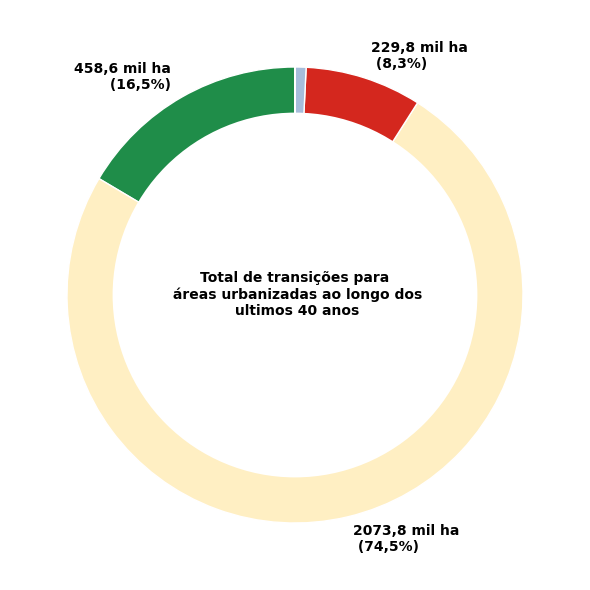

             fromClass  total (mil ha)  total (%)                    label
0       Áreas naturais           458.6       16.5   458,6 mil ha\n (16,5%)
1         Agropecuária          2073.8       74.5  2073,8 mil ha\n (74,5%)
2  Áreas não vegetadas           229.8        8.3    229,8 mil ha\n (8,3%)
3                 Água            21.4        0.8                         
4        Não observado             0.3        0.0                         


In [ ]:
# calculating the values
totalByClass = transitions_agg.drop(columns=['interval', 'total']).sum(axis=0).div(1000).reset_index()\
.rename(columns={0: 'total (mil ha)'})

totalByClass['total (%)'] = totalByClass['total (mil ha)'] / totalByClass['total (mil ha)'].sum() * 100

# rounding to one decimal
totalByClass['total (mil ha)'] = totalByClass['total (mil ha)'].round(1)
totalByClass['total (%)'] = totalByClass['total (%)'].round(1)
totalByClass['label'] = (totalByClass['total (mil ha)'].astype(str) + ' mil ha\n (' + totalByClass['total (%)'].astype(str) + '%)').str.replace('.', ',')

# hiding labels where percentages are less than x%
totalByClass['label'] = totalByClass.apply(lambda row: '' if row['total (%)'] < 1 else row['label'], axis=1)

# plotting as a donut chart
fig, ax = plt.subplots(figsize = (6,6))

wedges, texts = ax.pie(
    totalByClass['total (mil ha)'],
    labels = totalByClass['label'],
    colors = [simplifiedPalette[c] for c in totalByClass['fromClass']],
    startangle = 90,
    # labeldistance= 0.7,
    textprops={'fontsize': 10, 'weight': 'bold', },
    wedgeprops={'linewidth': 1, 'edgecolor': 'white'}
)

centre_circle = plt.Circle((0,0), 0.80, fc='white')
ax.add_artist(centre_circle)

# ax.legend(
#     wedges, totalByClass['fromClass'],
#     title=False,
#     bbox_to_anchor=(0.9, 0),
#     loc='lower left',
#     ncols=1,
#     frameon=False,
#     fontsize='small'
# )

ax.set_title(
    'Total de transições para\n áreas urbanizadas ao longo dos\n ultimos 40 anos',
    fontweight = 'bold', fontsize = 10, loc = 'center',
    y = 0.45
)

plt.tight_layout()

# exporting and showing
figName = f'transitions_total_sum'
figPath = f'{figFolder}{figName}.png'

# adding to the dictionary of figures
figureDict[figName] = figPath

plt.savefig(figName, dpi=300, bbox_inches='tight')
plt.show()

print(totalByClass)

###Plotting transitions by decade

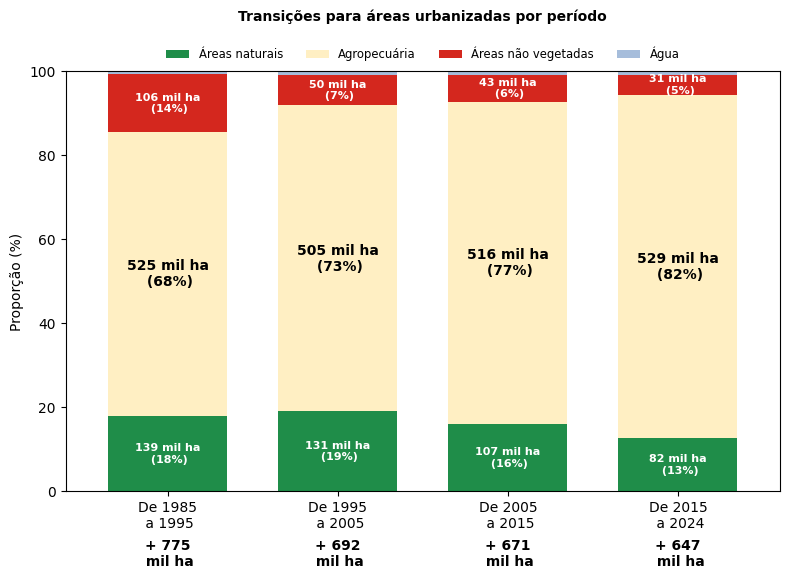

In [ ]:
# making a copy of the original df
df_percent = transitions_agg.copy()

# get the columns of the original dafaframe and drop the columns without value
cols = df_percent.columns.drop(['interval', 'total'])

# get the percentages
df_percent[cols] = df_percent[cols].div(df_percent[cols].sum(axis=1), axis=0) * 100

# setting th colors
colors = [
    simplifiedPalette[col] for col in cols
    ]

# preparing the plot
ax = df_percent.drop(columns=['total', 'Não observado']).plot(
    x='interval', kind='bar', width=0.7, stacked=True,
    figsize=(8,6),
    color=colors,
)

# details
ax.set_ylim(0, 100)

# getting the x positions
x_positions = [p.get_x() + p.get_width()/2 for p in ax.patches[:len(df_percent)]]

# due to low proportions, there is this list to avoid plotting the percentages written
classesToSkip = ['Água','Não observado']

# adding text to each segment
for i, (group, row) in enumerate(df_percent.iterrows()):
    # print(row)
    # print('---')
    # variable to use as a counter
    cumulative = 0
    for col in cols:
        area = round((transitions_agg[transitions_agg['interval']==row['interval']][col]/1000)[i])
        height = row[col]

        if col in classesToSkip:
          continue

        elif col == simplifiedClasses[2]: #agropecuaria
          if height > 0:
            ax.text(
                  x=x_positions[i],
                  y=cumulative + (height) / 2,
                  # s=f'{height:.0f}%',
                  s=f'{area} mil ha\n ({height:.0f}%)',
                  ha='center', va='center',
                  fontsize=10, color='black', fontweight='bold'
            )

        else:
          if height > 0:
            ax.text(
                  x=x_positions[i],
                  y=cumulative + height / 2,
                  # s=f'{height:.0f}%',
                  s=f'{area} mil ha\n ({height:.0f}%)',
                  ha='center', va='center',
                  fontsize=8, color='white', fontweight='bold'
            )
        cumulative += height

# annotations
for i in x_positions:
  i = int(i)
  total = list(transitions_agg['total'])[i]
  ax.text(
      x=x_positions[i],
      y=-15,
      s=f'+ {round(total/1000)}\n mil ha',
      ha='center', va='center',
      fontsize=10, color='black', fontweight='bold'
  )

# details
ax.set_title(
    'Transições para áreas urbanizadas por período',
    fontweight = 'bold', fontsize = 10,
    y = 1.1
)

plt.ylabel('Proporção (%)')
plt.xlabel('')
plt.xticks(rotation=0)
plt.legend(
    title=False,
    bbox_to_anchor=(0.5, 1),
    loc='lower center',
    ncols=4,
    frameon=False,
    fontsize='small'
)

plt.tight_layout()

# exporting and showing
figName = f'transitions_totalByDecade'
figPath = f'{figFolder}{figName}.png'

# adding to the dictionary of figures
figureDict[figName] = figPath

plt.savefig(figName, dpi=300, bbox_inches='tight')
plt.show()

### Highlights related to transitions to urban areas (overall view)

In [ ]:
# decade with the maximum urban growth
rowMaxGrowth = transitions_agg[transitions_agg['total']==transitions_agg['total'].max()]['interval'].iloc[0]

# decade with the minimum urban growth
rowMinGrowth = transitions_agg[transitions_agg['total']==transitions_agg['total'].min()]['interval'].iloc[0]

# maximum lost of natural areas
maxVegLostToUrban = round(transitions_agg[transitions_agg['interval']==rowMaxGrowth][simplifiedClasses[1]].iloc[0]/1000, 1)

# minimum lost of natural areas
minVegLostToUrban = round(transitions_agg[transitions_agg['interval']==rowMinGrowth][simplifiedClasses[1]].iloc[0]/1000, 1)

# difference between the first and last decade
diffVegLostToUrban = round(maxVegLostToUrban - minVegLostToUrban,1)

# total lost of veg due to urbanization
totalLostNat = round(transitions_agg['Áreas naturais'].sum()/1000, 1)

In [ ]:
# highlights
urbanTransitionsHighlight1 = f'{rowMaxGrowth} ocorreu o maior crescimento de áreas urbanizadas, '\
                             f'registrando também a maior perda de áreas naturais (da ordem de {str(maxVegLostToUrban).replace('.', ',')} mil ha).'\
                            .replace('\n', '')

urbanTransitionsHighlight2 = f'O ritmo de crescimento urbano sobre áreas naturais vem diminuindo '\
                             f'(diferença de {str(diffVegLostToUrban).replace('.', ',')} mil ha entre os períodos inicial e final).'\
                             .replace('\n', '')

urbanTransitionsHighlight3 = f'Apesar disso, entre {rowMinGrowth.replace('De ', '')} a perda de áreas naturais para áreas urbanizadas '\
                             f'foi de {str(minVegLostToUrban).replace('.', ',')} mil ha – maior do que o município de Florianópolis (SC) inteiro, por exemplo.'\
                             .replace('\n', '')

urbanTransitionsHighlight4 = f'A soma das perdas de áreas naturais para áreas urbanizadas por período é de '\
                             f'{str(totalLostNat).replace('.', ',')} mil ha – equivalente a 3 vezes a cidade do Rio de Janeiro. '\
                             .replace('\n', '')

# making a dictionary of highlights
highlightsDict = {
    1: {'h': urbanTransitionsHighlight1, 'name': 'urbanTransitionsHighlight1'},
    2: {'h': urbanTransitionsHighlight2, 'name': 'urbanTransitionsHighlight2'},
    3: {'h': urbanTransitionsHighlight3, 'name': 'urbanTransitionsHighlight3'},
    4: {'h': urbanTransitionsHighlight4, 'name': 'urbanTransitionsHighlight4'}
}

# exporting the highlights as images
width = 35
fontsize = 12

for i in highlightsDict.keys():
  highlight = highlightsDict[i]['h']
  name = highlightsDict[i]['name']

  fig, ax = plt.subplots(1, 1, figsize=(3, 1))
  ax.axis('off')

  # Use textwrap to format the string
  wrapped_h1 = textwrap.fill(highlight, width=width)

  # Annotate the plot with the wrapped text
  ax.annotate(
      wrapped_h1,
      xy=(0, 0),
      xytext=(0.5, 0),
      fontsize=fontsize,
      ha='center',  # Horizontal alignment: center
      va='center',  # Vertical alignment: center
  )
  plt.tight_layout()

  # # exporting and showing
  # figName = f'{figFolder}{name}.png'
  # highlightsDict[i]['local'] = figName
  # plt.savefig(figName, dpi=300, bbox_inches='tight')

  # exporting and showing
  figPath = f'{figFolder}{name}.png'

  # adding to the dictionary of figures
  figureDict[name] = figPath

  # saving
  plt.savefig(figPath, dpi=300, bbox_inches='tight')

  # closing
  plt.close()

print('done!')

done!


### Summary of urbanization by decade


In [ ]:
figureList = list(set(figureList))

print('Figure list:')
print('------------')
for i in range(0, len(figureList)):
  print(i, figureList[i])

highlightsList = list(set(highlightsList))

print(f'\nHighlights dictionary:')
print('----------------------')
for h in highlightsDict.keys():
  print(h, highlightsDict[h]['h'])

print('\nFigure dictionary:')
print('----------------')
for f in figureDict.keys():
  print(f, figureDict[f])

Figure list:
------------

Highlights dictionary:
----------------------
1 De 1985 a 1995 ocorreu o maior crescimento de áreas urbanizadas, registrando também a maior perda de áreas naturais (da ordem de 138,6 mil ha).
2 O ritmo de crescimento urbano sobre áreas naturais vem diminuindo (diferença de 56,9 mil ha entre os períodos inicial e final).
3 Apesar disso, entre 2015 a 2024 a perda de áreas naturais para áreas urbanizadas foi de 81,7 mil ha – maior do que o município de Florianópolis (SC) inteiro, por exemplo.
4 A soma das perdas de áreas naturais para áreas urbanizadas por período é de 458,6 mil ha – equivalente a 3 vezes a cidade do Rio de Janeiro. 

Figure dictionary:
----------------
transitions_total_sum /content/drive/MyDrive/mapbiomas/modurpy/col10/images/transitions_total_sum.png
transitions_totalByDecade /content/drive/MyDrive/mapbiomas/modurpy/col10/images/transitions_totalByDecade.png
urbanTransitionsHighlight1 /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urba

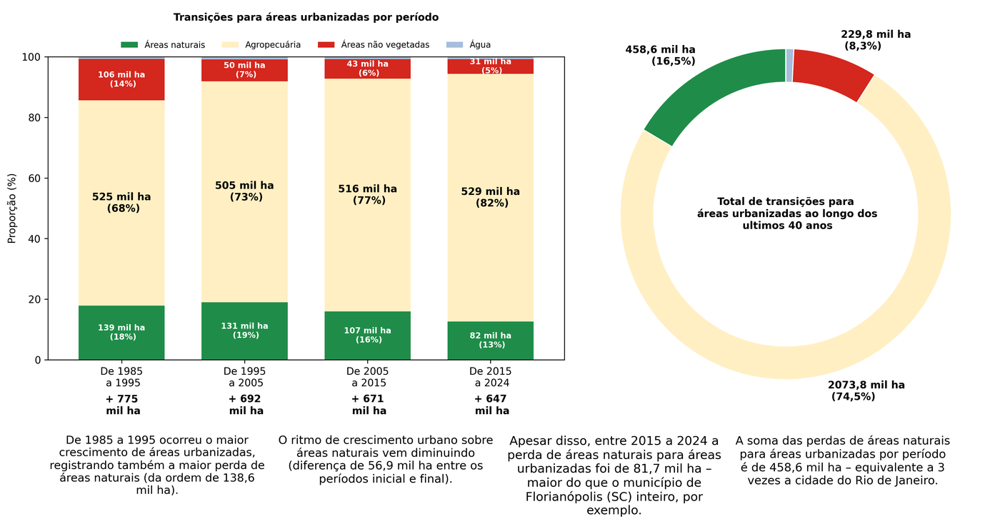

In [ ]:
# # plotting the transitions
# title = 'Transições para áreas urbanizadas por década'
# img1 = Image.open(figureList[0])
# img2 = Image.open(figureList[1])
# h1 = Image.open(highlightsDict[1]['local'])
# h2 = Image.open(highlightsDict[2]['local'])
# h3 = Image.open(highlightsDict[3]['local'])
# h4 = Image.open(highlightsDict[4]['local'])

# plotting the transitions
title = 'Transições para áreas urbanizadas por década'
img1 = Image.open(figureDict['transitions_totalByDecade'])
img2 = Image.open(figureDict['transitions_total_sum'])
h1 = Image.open(figureDict['urbanTransitionsHighlight1'])
h2 = Image.open(figureDict['urbanTransitionsHighlight2'])
h3 = Image.open(figureDict['urbanTransitionsHighlight3'])
h4 = Image.open(figureDict['urbanTransitionsHighlight4'])

# ---- images ----
# Resize while keeping proportions of graphs
max_size = (800, 600)   # (max_width, max_height)
img1.thumbnail(max_size, Image.LANCZOS)  # Keeps aspect ratio automatically
img2.thumbnail(max_size, Image.LANCZOS)  # Keeps aspect ratio automatically

# ---- highlights ----
# Resize while keeping proportions of graphs
max_size = (320, 600)   # (max_width, max_height)
h1.thumbnail(max_size, Image.LANCZOS)
h2.thumbnail(max_size, Image.LANCZOS)
h3.thumbnail(max_size, Image.LANCZOS)
h4.thumbnail(max_size, Image.LANCZOS)

# ---- create the canvas ----
# Get values to create the canvas
lon = max(img1.width+img2.width, h1.width+h2.width+h3.width+h4.width)
latMin = max(img1.height, img2.height)
lat = latMin + max(h1.height, h2.height, h3.height, h4.height)

# Create canvas
canvas = Image.new('RGB', (lon, lat), 'white')

# padding
minDistanceRow1 = (lon - (img1.width + img2.width))//2
minDistanceRow2 = (lon - (4*h1.width))//2

# pasting the images
canvas.paste(img1, (minDistanceRow1, (latMin - img1.height)//2))  # Center it
canvas.paste(img2, (minDistanceRow1 + img1.width, (latMin - img2.height)//2))  # Center it

# adding the highlights
canvas.paste(h1, (minDistanceRow2, latMin))
canvas.paste(h2, (minDistanceRow2 + h1.width, latMin))
canvas.paste(h3, (minDistanceRow2 + h1.width + h2.width, latMin))
canvas.paste(h4, (minDistanceRow2 + h1.width + h2.width + h3.width , latMin))

# naming and saving
figName = f'{figFolder}slide_transitions_bydecadeAndTotal.png'
canvas.save(figName)

# just checking
display(canvas)

##Obtaining transitions areas by biome

In [ ]:
# obtaining the transitions and aggregating it for the entire brazilain territory
transitions_agg_bio = (
    transitions_df.groupby(['interval', 'fromClass', 'bioma'], as_index=False)
    .agg({'area': 'sum'})
)

# renaming the intervals and classes adequatelly
transitions_agg_bio['interval'] = transitions_agg_bio['interval'].map(nameByDecade)
transitions_agg_bio['fromClass'] = transitions_agg_bio['fromClass'].map(simplifiedClasses)
transitions_agg_bio['bioma'] = transitions_agg_bio['bioma'].map(bioma)

display(transitions_agg_bio.head())

,interval,fromClass,bioma,area
0,De 1985\n a 1995,Áreas naturais,Amazônia,14185.124976
1,De 1985\n a 1995,Áreas naturais,Mata Atlântica,24280.038192
2,De 1985\n a 1995,Áreas naturais,Pantanal,180.426615
3,De 1985\n a 1995,Áreas naturais,Cerrado,63507.312072
4,De 1985\n a 1995,Áreas naturais,Caatinga,23820.184060


###Plotting the area of transtions by biome (percentages)

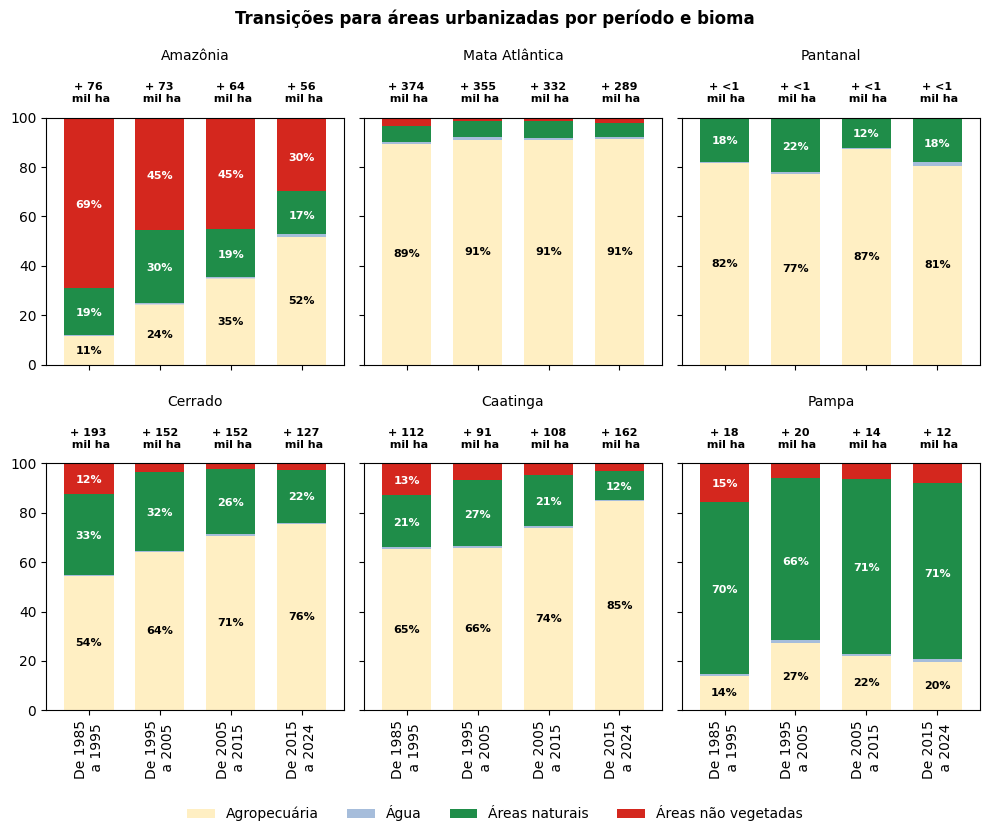

In [ ]:
# list of biomes to iterate
biomes = transitions_agg_bio['bioma'].unique()

# creating a 3x3 subplot for biomes
ncols = 3
nrows = 2

fig, axes = plt.subplots(2, 3, figsize=(10, 8), sharex=True, sharey = True)
axes = axes.flatten()

for i, b in enumerate(biomes):

  # filter the data by biome
  transitions_agg_bio_pv = transitions_agg_bio[transitions_agg_bio['bioma'] == b].drop(columns='bioma')\
  .pivot(index='interval', columns='fromClass', values='area').reset_index()\
  .drop(columns='Áreas urbanas')

  # getting the total of area (will be used later)
  colsToSum = transitions_agg_bio_pv.columns.drop(['interval'])

  transitions_agg_bio_pv['total'] = transitions_agg_bio_pv[colsToSum].sum(axis=1)

  # making a copy of the original df
  df_percent = transitions_agg_bio_pv.copy()

  # get the columns of the original dafaframe and drop the columns without value
  cols = df_percent.columns.drop(['interval', 'total'])

  # get the percentages
  df_percent[cols] = df_percent[cols].div(df_percent[cols].sum(axis=1), axis=0) * 100

  # setting th colors
  colors = [
      simplifiedPalette[col] for col in cols
      ]

  # preparing the plot
  ax = df_percent.drop(columns=['total']).plot(
      x='interval', kind='bar', stacked=True, ax = axes[i],
      color=colors,
      legend=False,
      width=0.7
  )

  # getting the x positions
  x_positions = [p.get_x() + p.get_width()/2 for p in ax.patches[:len(df_percent)]]

  # --- annotations ---
  # due to low proportions, there is this list to avoid plotting the percentages written
  classesToSkip = ['Água','Não observado']

  # adding text to each segment
  for i, (group, row) in enumerate(df_percent.iterrows()):

      # variable to use as a counter
      cumulative = 0
      for col in cols:
          height = row[col]

          if col in classesToSkip:
            continue

          elif col == simplifiedClasses[2]: #agropecuaria
            if height > 10:
              ax.text(
                    x=x_positions[i],
                    y=cumulative + (height) / 2,
                    s=f'{height:.0f}%',
                    ha='center', va='center',
                    fontsize=8, color='black', fontweight='bold'
              )

          else:
            if height > 10:
              ax.text(
                    x=x_positions[i],
                    y=cumulative + height / 2,
                    s=f'{height:.0f}%',
                    ha='center', va='center',
                    fontsize=8, color='white', fontweight='bold'
              )
          cumulative += height

  # annotating results
  for i in x_positions:

    i = int(i)
    total = list(transitions_agg_bio_pv['total'])[i]

    val = round(total/1000)

    if val <= 1:
      # val = '<1'
      textResult = f'+ <1\n mil ha'
    else:
      textResult = f'+ {val}\n mil ha'

    ax.text(
        x=x_positions[i],
        y=110,
        s=textResult,
        ha='center', va='center',
        fontsize=8, color='black', fontweight='bold'
    )

  # setting the details
  ax.set_title(f"{b}", fontsize=10, y=1.2)
  ax.set_xlabel("")
  ax.set_ylabel("")

  # setting the y-axis limits
  ax.set_ylim(0, 100)

# setting the legend
handles, labels = ax.get_legend_handles_labels()

# filering unecessary labes and legends
filtered_handles = []
filtered_labels = []

for handle, label in zip(handles, labels):
    if label != 'Não observado':
        filtered_handles.append(handle)
        filtered_labels.append(label)

fig.legend(filtered_handles, filtered_labels, title=False, bbox_to_anchor=(0.5, -0.05), loc='lower center', ncols=4, frameon=False)

# title
fig.suptitle('Transições para áreas urbanizadas por período e bioma', fontsize=12, fontweight = 'bold', color='black')

# adjusting the layout
plt.tight_layout()

# exporting and showing
figName = f'transitions_byBiome'
figPath = f'{figFolder}{figName}.png'

# adding to the dictionary of figures
figureDict[figName] = figPath

# exporting and showing
plt.savefig(figPath, dpi=300, bbox_inches='tight')
plt.show()



###Plotting the natural area lost to urbanization by biome

####Loading the biomes

In [ ]:
# biomes
shpBiomes = '/content/drive/MyDrive/shapefiles/Biomas_250mil/lm_bioma_250.shp'

In [ ]:
# aggregating and filtering
transitions_agg_bio_total = transitions_agg_bio.groupby(['fromClass', 'bioma'], as_index=False).agg({'area': 'sum'})
transitions_agg_bio_total = transitions_agg_bio_total[transitions_agg_bio_total['fromClass'] == 'Áreas naturais']

# load the state shapefile
gdf_territory = gpd.read_file(shpBiomes)

# merging with the transitions
gdf_merged = gdf_territory.merge(transitions_agg_bio_total, left_on="Bioma", right_on='bioma')

# creating a column to be used as labels
gdf_merged['label'] = gdf_merged['area'].apply(lambda x: f'-{x/1000:.0f}\n mil ha')
gdf_merged.head()

# display(gdf_merged.head())

,Bioma,CD_Bioma,geometry,fromClass,bioma,area,label
0,Amazônia,1,"MULTIPOLYGON (((-44.08515 -2.41669, -44.0856 -...",Áreas naturais,Amazônia,57973.759717,-58\n mil ha
1,Caatinga,2,"POLYGON ((-41.7408 -2.80826, -41.73673 -2.8093...",Áreas naturais,Caatinga,90475.297018,-90\n mil ha
2,Cerrado,3,"POLYGON ((-43.39009 -2.33937, -43.38741 -2.342...",Áreas naturais,Cerrado,178883.836834,-179\n mil ha
3,Mata Atlântica,4,"MULTIPOLYGON (((-48.70814 -28.44851, -48.70994...",Áreas naturais,Mata Atlântica,85994.965319,-86\n mil ha
4,Pampa,5,"POLYGON ((-52.82472 -27.46295, -52.81558 -27.4...",Áreas naturais,Pampa,44776.560922,-45\n mil ha


####Plotting the results by biome

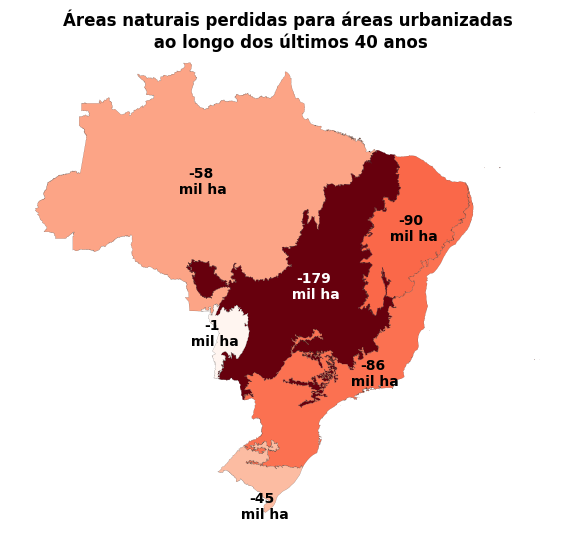

In [ ]:
# informing the gdf (this is how we do to reuse our codes easily)
gdf = gdf_merged

# Create figure and subplots
fig, ax = plt.subplots(1, 1, figsize=(8, 6))

# Choose colormap
cmap = plt.cm.Reds

# Normalize for consistent coloring
norm = mpl.colors.Normalize(vmin=gdf_merged['area'].min(), vmax=gdf_merged['area'].max())

# Plot each column
gdf.plot(
    column='area',
    cmap=cmap,
    linewidth=0.08,
    edgecolor="black",
    ax=ax,
    norm=norm  # same color scale
)

# ax.set_title('This is the title',fontsize=10, y=1)
ax.axis('off')

fontsize = 10

# Add labels
for idx, row in gdf.iterrows():
    if row['geometry'].centroid.is_empty:
        continue

    if row['bioma'] == 'Pantanal':
      x, y = row['geometry'].centroid.coords[0]
      ax.text(x-1.5, y, row['label'], fontsize=fontsize, ha='center', va='center', color='black', fontweight='bold')
      # print(x, y)

    elif row['bioma'] == 'Mata Atlântica':
      x, y = row['geometry'].centroid.coords[0]
      ax.text(x+3, y, row['label'], fontsize=fontsize, ha='center', va='center', color='black', fontweight='bold')

    elif row['bioma'] == 'Cerrado':
      x, y = row['geometry'].centroid.coords[0]
      ax.text(x, y, row['label'], fontsize=fontsize, ha='center', va='center', color='white', fontweight='bold')

    elif row['bioma'] == 'Pampa':
      x, y = row['geometry'].centroid.coords[0]
      ax.text(x, y-3, row['label'], fontsize=fontsize, ha='center', va='center', color='black', fontweight='bold')

    else:
      x, y = row['geometry'].centroid.coords[0]
      ax.text(x, y, row['label'], fontsize=fontsize, ha='center', va='center', color='black', fontweight='bold')

# Add legend
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

# adjusting the plotting
plt.tight_layout(rect=[0, 0, 1, 1])
plt.tight_layout()

fig.subplots_adjust(top=0.85)

# setting the title
fig.suptitle('Áreas naturais perdidas para áreas urbanizadas\n ao longo dos últimos 40 anos', fontsize=12, fontweight = 'bold', color='black', y=0.9)

# exporting and showing
figName = f'map_vegLostByBiome'
figPath = f'{figFolder}{figName}.png'

# adding to the dictionary of figures
figureDict[figName] = figPath

# exporting and showing
plt.savefig(figPath, dpi=300, bbox_inches='tight')
plt.show()

###Highlights related to transitions to urban areas (by biome)

In [ ]:
# decade with the maximum urban growth
areaMaxGrowthByBio = transitions_agg_bio_total[transitions_agg_bio_total['area']==transitions_agg_bio_total['area'].max()]['area'].iloc[0]

#
val1 = transitions_agg_bio[
        (transitions_agg_bio['bioma']=='Pampa') &
        (transitions_agg_bio['fromClass']=='Áreas naturais') &
        (transitions_agg_bio['fromClass']!='Áreas urbanas')
        # (transitions_agg_bio['interval']=='De 1985\n a 1995')
    ]['area'].sum()

val2 = transitions_agg_bio[
        (transitions_agg_bio['bioma']=='Pampa') &
        (transitions_agg_bio['fromClass']!='Áreas urbanas')
        # (transitions_agg_bio['interval']=='De 1985\n a 1995')
    ]['area'].sum()

percentChangeMaxBio = round(100*val1/val2, 1)

In [ ]:
# highlights
urbanTransHighlightByBiome1 = f'O Cerrado foi o bioma que mais perdeu áreas naturais para áreas urbanizadas, '\
                              f'somando {str(round(areaMaxGrowthByBio/1000, 1)).replace('.', ',')} mil ha.'\
                             .replace('\n', '')

urbanTransHighlightByBiome2 = f'Proporcionalmente, o crescimento urbano sobre áreas naturais foi maior no Pampa. '\
                              f'Cerca de {str(percentChangeMaxBio).replace('.', ',')}% de toda a expansão urbana ao longo dos periodos '\
                              f'analisados ocorreu sobre areas naturais.'\
                              .replace('\n', '')

# making a dictionary of highlights
highlightsDictByBio = {
    1: {'h': urbanTransHighlightByBiome1, 'name': 'urbanTransHighlightByBiome1'},
    2: {'h': urbanTransHighlightByBiome2, 'name': 'urbanTransHighlightByBiome2'},
}

# exporting the highlights as images
width = 35
fontsize = 12

for i in highlightsDictByBio.keys():
  highlight = highlightsDictByBio[i]['h']
  name = highlightsDictByBio[i]['name']

  fig, ax = plt.subplots(1, 1, figsize=(3, 1))
  ax.axis('off')

  # Use textwrap to format the string
  wrapped_h1 = textwrap.fill(highlight, width=width)

  # Annotate the plot with the wrapped text
  ax.annotate(
      wrapped_h1,
      xy=(0, 0),
      xytext=(0.5, 0),
      fontsize=fontsize,
      ha='center',  # Horizontal alignment: center
      va='center',  # Vertical alignment: center
  )
  plt.tight_layout()

  # exporting and showing
  figPath = f'{figFolder}{name}.png'

  # adding to the dictionary of figures
  figureDict[name] = figPath

  # saving
  plt.savefig(figPath, dpi=300, bbox_inches='tight')

  # closing
  plt.close()

print('done!')

done!


### Summary of urbanization by decade by biome

In [ ]:
print('\nFigure dictionary:')
print('----------------')
for f in figureDict.keys():
  print(f, '    ---->    ', figureDict[f])


Figure dictionary:
----------------
transitions_total_sum     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/transitions_total_sum.png
transitions_totalByDecade     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/transitions_totalByDecade.png
urbanTransitionsHighlight1     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urbanTransitionsHighlight1.png
urbanTransitionsHighlight2     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urbanTransitionsHighlight2.png
urbanTransitionsHighlight3     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urbanTransitionsHighlight3.png
urbanTransitionsHighlight4     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urbanTransitionsHighlight4.png
transitions_byBiome     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/transitions_byBiome.png
map_vegLostByBiome     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/map_vegLostByBiome.p

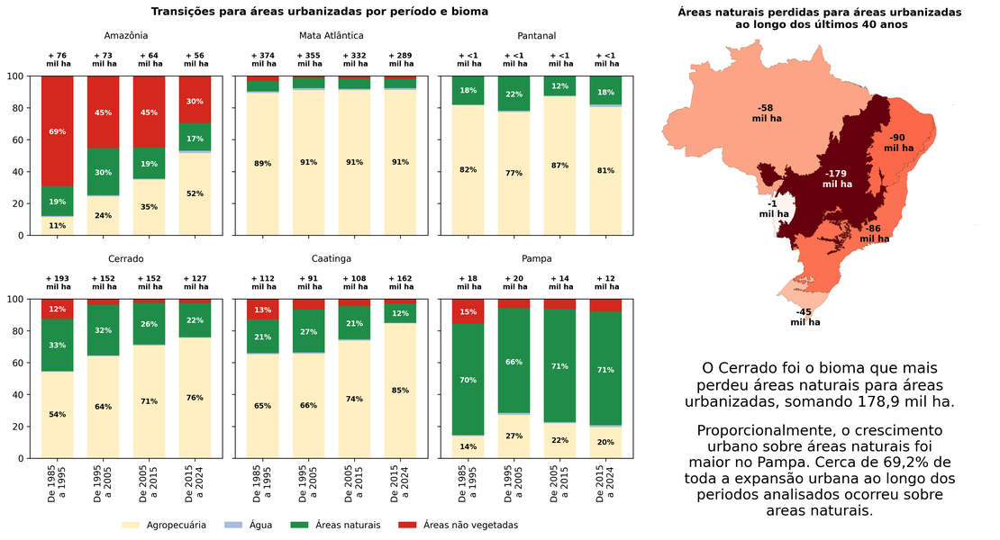

In [ ]:
# plotting the transitions by biome
title = 'Transições para áreas urbanizadas por década'
img1 = Image.open(figureDict['transitions_byBiome'])
img2 = Image.open(figureDict['map_vegLostByBiome'])
h1 = Image.open(figureDict['urbanTransHighlightByBiome1'])
h2 = Image.open(figureDict['urbanTransHighlightByBiome2'])

# ---- images ----
# Resize while keeping proportions of graphs
max_size = (800, 600)   # (max_width, max_height)
img1.thumbnail((1200, 600), Image.LANCZOS)  # Keeps aspect ratio automatically
img2.thumbnail((400, 600), Image.LANCZOS)  # Keeps aspect ratio automatically

# ---- highlights ----
# Resize while keeping proportions of graphs
max_size = (320, 600)   # (max_width, max_height)
h1.thumbnail(max_size, Image.LANCZOS)
h2.thumbnail(max_size, Image.LANCZOS)

# ---- create the canvas ----
# Get values to create the canvas
lon = max(img1.width+img2.width, img1.width+h1.width)
latMin = max(img1.height, img2.height+2*h1.width)
latMin = img1.height
lat = latMin #+ max(h1.height, h2.height, h3.height, h4.height)

# Create canvas
canvas = Image.new('RGB', (lon, lat), 'white')

# padding
minDistanceRow1 = (lon - (img1.width + img2.width))//2
# minDistanceRow2 = (lon - (4*h1.width))//2

# pasting the images
canvas.paste(img1, (minDistanceRow1, 0))  # Center it #(latMin - img1.height)//2
canvas.paste(img2, (minDistanceRow1 + img1.width, 0))  # Center it

# adding the highlights
canvas.paste(h1, (minDistanceRow1 + img1.width + (img2.width - h1.width)//2, img2.height))
canvas.paste(h2, (minDistanceRow1 + img1.width + (img2.width - h1.width)//2, img2.height+h2.height-40))

# naming and saving
figName = f'slide_transitions_byDecadeByBiome'

# exporting and showing
figPath = f'{figFolder}{figName}.png'

# adding to the dictionary of figures
figureDict[figName] = figPath

canvas.save(figPath)

# just checking
display(canvas)

##Obtaining transitions areas by state

In [ ]:
#
transitions_df_byState = transitions_df
transitions_df_byState['state']=transitions_df_byState['territory'].astype(str).str[:2].astype(int)

# obtaining the transitions and aggregating it for the entire brazilain territory
transitions_agg_state = (
    transitions_df.groupby(['interval', 'fromClass', 'state'], as_index=False)
    .agg({'area': 'sum'})
)

# renaming the intervals and classes adequatelly
transitions_agg_state['interval'] = transitions_agg_state['interval'].map(nameByDecade)
transitions_agg_state['fromClass'] = transitions_agg_state['fromClass'].map(simplifiedClasses)
transitions_agg_state['state'] = transitions_agg_state['state'].map(states)

display(transitions_agg_state.head())

,interval,fromClass,state,area
0,De 1985\n a 1995,Áreas naturais,Rondônia,369.572992
1,De 1985\n a 1995,Áreas naturais,Acre,150.832994
2,De 1985\n a 1995,Áreas naturais,Amazonas,700.807488
3,De 1985\n a 1995,Áreas naturais,Roraima,988.855879
4,De 1985\n a 1995,Áreas naturais,Pará,5937.476648


###Plotting the area of transtions by state

we will use heatmaps (too many data for other format to handle it...).

/tmp/ipython-input-3146317018.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '< 1 mil ha' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  annot.loc[i, j] = f"< 1 mil ha"
/tmp/ipython-input-3146317018.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '< 1 mil ha' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  annot.loc[i, j] = f"< 1 mil ha"
/tmp/ipython-input-3146317018.py:25: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '< 1 mil ha' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  annot.loc[i, j] = f"< 1 mil ha"
/tmp/ipython-input-3146317018.py:25: FutureWarning: Setting an item of incompatible dtype is depr

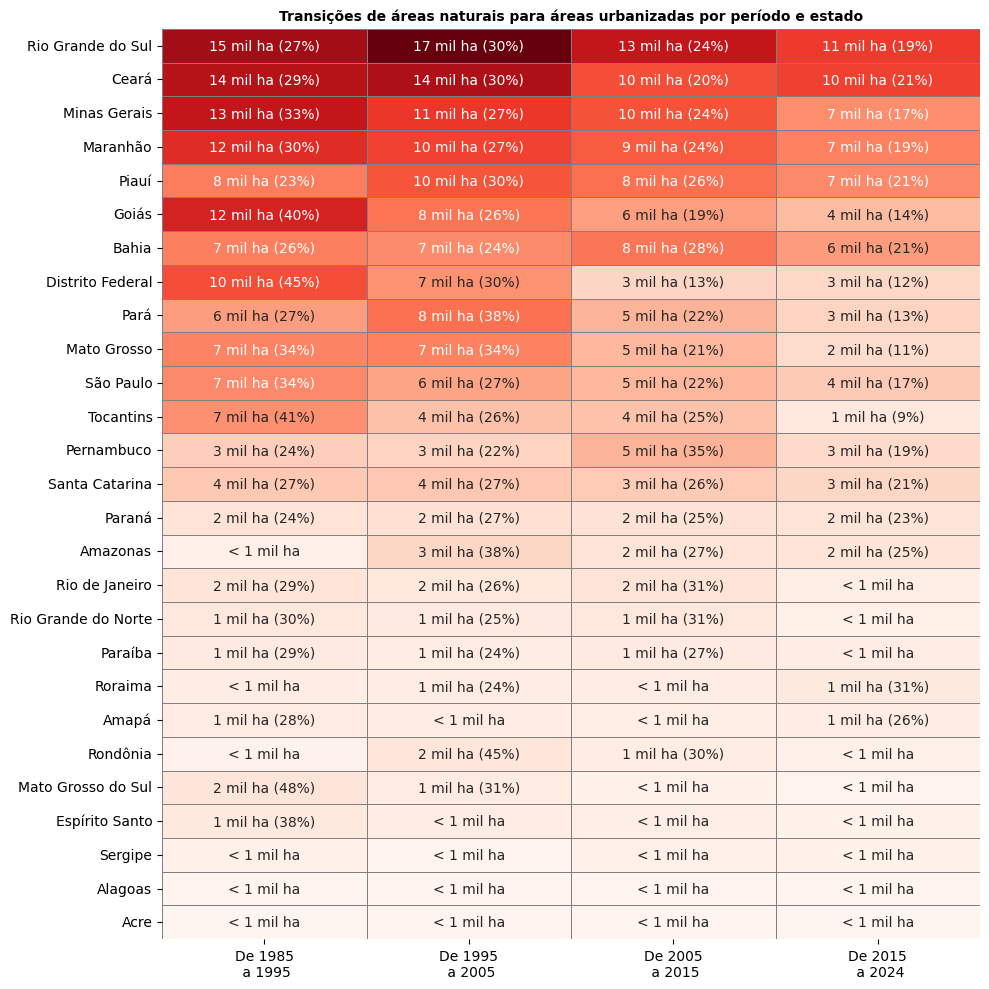

In [ ]:
# Filter only transitions from natural areas
df = transitions_agg_state
df_nat = df[df['fromClass'] == 'Áreas naturais']

# Pivot: area per state and period
pivot_area = (
    df_nat.groupby(['state', 'interval'])['area']
    .sum()
    .reset_index()
    .pivot(index='state', columns='interval', values='area')
    .fillna(0)
)

# Calculate % of total per state (row-wise)
pivot_pct = pivot_area.div(pivot_area.sum(axis=1), axis=0) * 100

# Create text annotations: "### mil ha (##%)"
annot = pivot_area.copy()
for i in pivot_area.index:
    for j in pivot_area.columns:
        area_val = pivot_area.loc[i, j] / 1e3  # convert to mil ha

        if area_val< 1:
          pct_val = None
          annot.loc[i, j] = f"< 1 mil ha"
        else:
          pct_val = pivot_pct.loc[i, j]
          annot.loc[i, j] = f"{area_val:.0f} mil ha ({pct_val:.0f}%)" if area_val > 0 else None

# Sort states by total converted area
order = pivot_area.sum(axis=1).sort_values(ascending=False).index
pivot_area = pivot_area.loc[order]
annot = annot.loc[order]

# Plot
plt.figure(figsize=(10, 10))
sns.heatmap(
    pivot_area,
    cmap="Reds",
    linewidths=0.5,
    linecolor="gray",
    annot=annot,
    fmt="",
    cbar=False,
    # cbar_kws={'label': 'Area converted to Urban (ha)'},
)

plt.title("Transições de áreas naturais para áreas urbanizadas por período e estado", fontsize=10, fontweight='bold')
plt.xlabel("")
plt.ylabel("")
plt.tight_layout()

# naming and saving
figName = f'transitions_ByState'

# exporting and showing
figPath = f'{figFolder}{figName}.png'

# adding to the dictionary of figures
figureDict[figName] = figPath

# saving
plt.savefig(figPath, dpi=300, bbox_inches='tight')

plt.show()

####Loading the states

In [ ]:
# states
shpStates = "/content/drive/MyDrive/shapefiles/BR_UF_2021/BR_UF_2021.shp"

In [ ]:
transitions_agg_bio_total

,fromClass,bioma,area
17,Áreas naturais,Amazônia,57973.759717
18,Áreas naturais,Caatinga,90475.297018
19,Áreas naturais,Cerrado,178883.836834
20,Áreas naturais,Mata Atlântica,85994.965319
21,Áreas naturais,Pampa,44776.560922
22,Áreas naturais,Pantanal,500.542799


In [ ]:
# aggregating and filtering
transitions_agg_state_total = transitions_agg_state.groupby(['fromClass', 'state'], as_index=False).agg({'area': 'sum'})
transitions_agg_state_total = transitions_agg_state_total[transitions_agg_state_total['fromClass'] == 'Áreas naturais']

# load the state shapefile
gdf_states = gpd.read_file(shpStates)

# merging with the transitions
gdf_merged_states = gdf_states.merge(transitions_agg_state_total, left_on="NM_UF", right_on='state')

# creating a column to be used as labels
gdf_merged_states['label'] = gdf_merged_states['area'].apply(lambda x: f'-{x/1000:.0f}\n mil ha')
gdf_merged_states.head()

,CD_UF,NM_UF,SIGLA,NM_REGIAO,AREA_KM2,geometry,fromClass,state,area,label
0,12,Acre,AC,Norte,164173.429,"POLYGON ((-68.79282 -10.99957, -68.79367 -10.9...",Áreas naturais,Acre,634.204456,-1\n mil ha
1,13,Amazonas,AM,Norte,1559255.881,"POLYGON ((-56.76292 -3.23221, -56.76789 -3.242...",Áreas naturais,Amazonas,7190.321294,-7\n mil ha
2,15,Pará,PA,Norte,1245870.704,"MULTIPOLYGON (((-48.97548 -0.19834, -48.97487 ...",Áreas naturais,Pará,21859.004405,-22\n mil ha
3,16,Amapá,AP,Norte,142470.762,"MULTIPOLYGON (((-51.04561 -0.05088, -51.05422 ...",Áreas naturais,Amapá,3997.560644,-4\n mil ha
4,17,Tocantins,TO,Norte,277423.627,"POLYGON ((-48.2483 -13.19239, -48.24844 -13.19...",Áreas naturais,Tocantins,15964.411235,-16\n mil ha


####Plotting the results by state

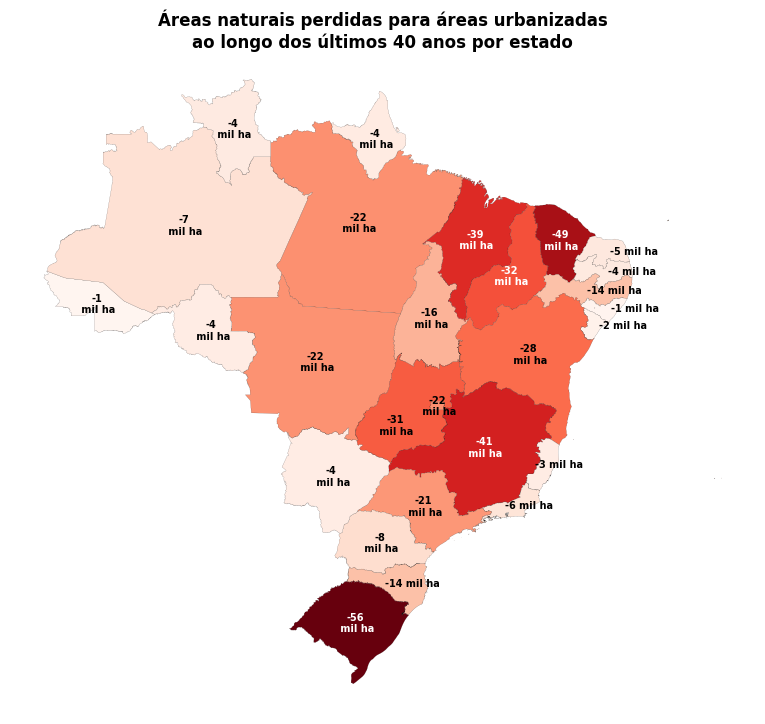

In [ ]:

# informing the gdf (this is how we do to reuse our codes easily)
gdf = gdf_merged_states

# Create figure and subplots
fig, ax = plt.subplots(1, 1, figsize=(10, 8))

# Choose colormap
cmap = plt.cm.Reds

# Normalize for consistent coloring
norm = mpl.colors.Normalize(vmin=gdf['area'].min(), vmax=gdf['area'].max())

# Plot each column
gdf.plot(
    column='area',
    cmap=cmap,
    linewidth=0.08,
    edgecolor="black",
    ax=ax,
    norm=norm
)

ax.axis('off')
fontsize = 7

# Add labels with adaptive color
for idx, row in gdf.iterrows():
    if row['geometry'].centroid.is_empty:
        continue

    # Get color brightness (0=dark, 1=bright)
    rgba = cmap(norm(row['area']))
    brightness = (0.299 * rgba[0] + 0.587 * rgba[1] + 0.114 * rgba[2])  # luminance formula

    text_color = 'white' if brightness < 0.5 else 'black'

    # Adjust x slightly for narrow states
    x, y = row['geometry'].centroid.coords[0]
    if row['state'] in ['Rio Grande do Norte', 'Paraíba', 'Pernambuco', 'Alagoas', 'Sergipe']:
        x += 2
        row['label'] = row['label'].replace('\n', '')

    if row['state'] in ['Santa Catarina', 'Espírito Santo', 'Rio de Janeiro']:
        x += 1
        row['label'] = row['label'].replace('\n', '')

    if row['state'] in ['Goiás']:
        x -= 1
        y -= 1

    ax.text(
        x, y, row['label'],
        fontsize=fontsize,
        ha='center', va='center',
        color=text_color,
        fontweight='bold'
    )

# Add legend
sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
sm.set_array([])

plt.tight_layout(rect=[0, 0, 1, 1])
fig.subplots_adjust(top=0.85)

fig.suptitle(
    'Áreas naturais perdidas para áreas urbanizadas\nao longo dos últimos 40 anos por estado',
    fontsize=12, fontweight='bold', color='black', y=0.9
)

# exporting and showing
figName = f'map_vegLostByState'
figPath = f'{figFolder}{figName}.png'

# adding to the dictionary of figures
figureDict[figName] = figPath

# exporting and showing
plt.savefig(figPath, dpi=300, bbox_inches='tight')

plt.show()

###Highlights related to transitions to urban areas (by state)

In [ ]:
# decade with the maximum urban growth
areaMaxGrowthByState = transitions_agg_state_total[transitions_agg_state_total['area']==transitions_agg_state_total['area'].max()]['area'].iloc[0]

# #
# val1 = transitions_agg_state[
#         (transitions_agg_state['bioma']=='Pampa') &
#         (transitions_agg_state['fromClass']=='Áreas naturais') &
#         (transitions_agg_state['fromClass']!='Áreas urbanas')
#         # (transitions_agg_bio['interval']=='De 1985\n a 1995')
#     ]['area'].sum()

# val2 = transitions_agg_state[
#         (transitions_agg_state['bioma']=='Pampa') &
#         (transitions_agg_state['fromClass']!='Áreas urbanas')
#         # (transitions_agg_bio['interval']=='De 1985\n a 1995')
#     ]['area'].sum()

# percentChangeMaxState = round(100*val1/val2, 1)

In [ ]:
# highlights
urbanTransHighlightByState1 = f'Rio Grande do Sul foi o estado que mais perdeu áreas naturais para áreas urbanizadas, '\
                              f'somando {str(round(areaMaxGrowthByState/1000, 1)).replace('.', ',')} mil ha.'\
                             .replace('\n', '')

urbanTransHighlightByState2 = f'Em todos os estados o crescimento urbano sobre áreas naturais vem diminuindo. '\
                              f'Porém, dentre os 5 estados com maiores perdas no último período, 3 deles são do Nordeste.'\
                              .replace('\n', '')

# making a dictionary of highlights
highlightsDictByState = {
    1: {'h': urbanTransHighlightByState1, 'name': 'urbanTransHighlightByState1'},
    2: {'h': urbanTransHighlightByState2, 'name': 'urbanTransHighlightByState2'},
}

# exporting the highlights as images
width = 50
fontsize = 12

for i in highlightsDictByState.keys():
  highlight = highlightsDictByState[i]['h']
  name = highlightsDictByState[i]['name']

  fig, ax = plt.subplots(1, 1, figsize=(3, 1))
  ax.axis('off')

  # Use textwrap to format the string
  wrapped_h1 = textwrap.fill(highlight, width=width)

  # Annotate the plot with the wrapped text
  ax.annotate(
      wrapped_h1,
      xy=(0, 0),
      xytext=(0.5, 0),
      fontsize=fontsize,
      ha='center',  # Horizontal alignment: center
      va='center',  # Vertical alignment: center
  )
  plt.tight_layout()

  # exporting and showing
  figPath = f'{figFolder}{name}.png'

  # adding to the dictionary of figures
  figureDict[name] = figPath

  # saving
  plt.savefig(figPath, dpi=300, bbox_inches='tight')

  # closing
  plt.close()

print('done!')

done!


### Summary of urbanization by decade by state

In [ ]:
print('\nFigure dictionary:')
print('----------------')
for f in figureDict.keys():
  print(f, '    ---->    ', figureDict[f])


Figure dictionary:
----------------
transitions_total_sum     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/transitions_total_sum.png
transitions_totalByDecade     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/transitions_totalByDecade.png
urbanTransitionsHighlight1     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urbanTransitionsHighlight1.png
urbanTransitionsHighlight2     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urbanTransitionsHighlight2.png
urbanTransitionsHighlight3     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urbanTransitionsHighlight3.png
urbanTransitionsHighlight4     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/urbanTransitionsHighlight4.png
transitions_byBiome     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/transitions_byBiome.png
map_vegLostByBiome     ---->     /content/drive/MyDrive/mapbiomas/modurpy/col10/images/map_vegLostByBiome.p

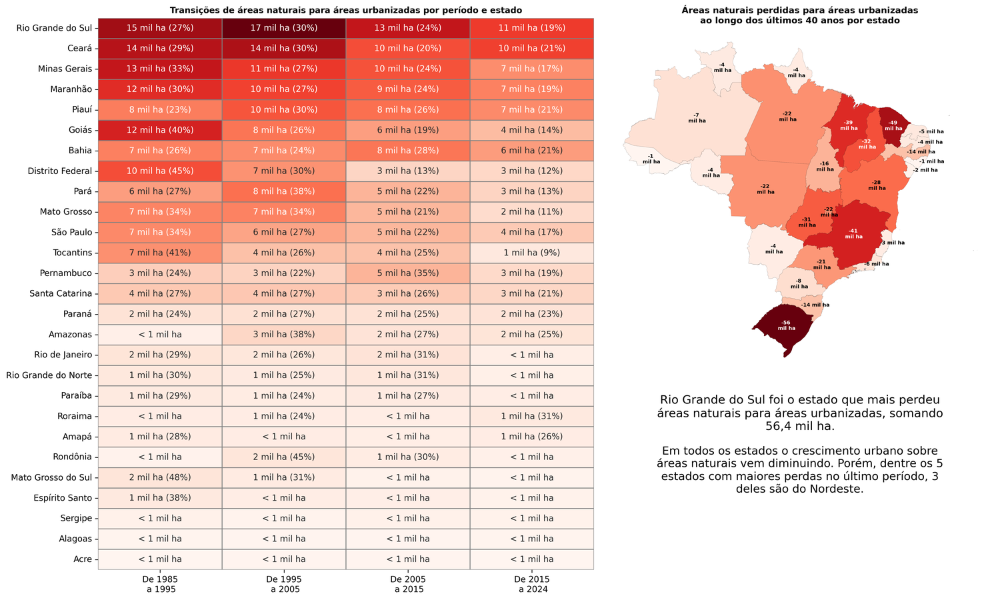

In [ ]:
# plotting the transitions by biome
title = 'Transições para áreas urbanizadas por década'
img1 = Image.open(figureDict['transitions_ByState'])
img2 = Image.open(figureDict['map_vegLostByState'])
h1 = Image.open(figureDict['urbanTransHighlightByState1'])
h2 = Image.open(figureDict['urbanTransHighlightByState2'])

# ---- images ----
# Resize while keeping proportions of graphs
max_size = (800, 600)   # (max_width, max_height)
img1.thumbnail((1200, 900), Image.LANCZOS)  # Keeps aspect ratio automatically
img2.thumbnail((600, 600), Image.LANCZOS)  # Keeps aspect ratio automatically

# ---- highlights ----
# Resize while keeping proportions of graphs
max_size = (450, 600)   # (max_width, max_height)
h1.thumbnail(max_size, Image.LANCZOS)
h2.thumbnail(max_size, Image.LANCZOS)

# ---- create the canvas ----
# Get values to create the canvas
lon = max(img1.width+img2.width, img1.width+h1.width)
latMin = max(img1.height, img2.height+2*h1.width)
latMin = img1.height
lat = latMin #+ max(h1.height, h2.height, h3.height, h4.height)

# Create canvas
canvas = Image.new('RGB', (lon, lat), 'white')

# padding
minDistanceRow1 = (lon - (img1.width + img2.width))//2
# minDistanceRow2 = (lon - (4*h1.width))//2

# pasting the images
canvas.paste(img1, (minDistanceRow1, 0))  # Center it #(latMin - img1.height)//2
canvas.paste(img2, (minDistanceRow1 + img1.width, 0))  # Center it

# adding the highlights
canvas.paste(h1, (minDistanceRow1 + img1.width + (img2.width - h1.width)//2, img2.height))
canvas.paste(h2, (minDistanceRow1 + img1.width + (img2.width - h1.width)//2, img2.height+h1.height))

# naming and saving
figName = f'slide_transitions_byDecadeByState'

# exporting and showing
figPath = f'{figFolder}{figName}.png'

# adding to the dictionary of figures
figureDict[figName] = figPath

canvas.save(figPath)

# just checking
display(canvas)

#Crossing themes - Urbanization on environmental resources

##Preparing the main dataframe

In [ ]:
# creating a copy of the main df
df_cross = merged_df

# territories (mun and state)
df_cross['territory'] = df_cross['territory'].astype(str)
df_cross['state'] = df_cross['territory'].str[0:2].astype(int)

# class as str to get the digits
df_cross['class'] = df_cross['class'].astype(str)

# separete the colums
df_cross['slope'] = df_cross['class'].str[0].astype(int)
df_cross['hand'] = df_cross['class'].str[1].astype(int)
df_cross['slums'] = df_cross['class'].str[2].astype(int)
df_cross['urbanPerim'] = df_cross['class'].str[3].astype(int)
df_cross['risk'] = df_cross['class'].str[4].astype(int)
df_cross['vegurb'] = df_cross['class'].str[5].astype(int)

# # making all na as 0
df_cross.fillna(0, inplace=True)
# df = df[df[keys].isna()].fillna(0)

# distplay the values
display(df_cross.head())

,area,bioma,class,territory,year,state,slope,hand,slums,urbanPerim,risk,vegurb
0,0.962,1,312121,1100015,2005,11,3,1,2,1,2,1
1,6.826,1,312123,1100015,2005,11,3,1,2,1,2,3
2,0.437,1,312223,1100015,2005,11,3,1,2,2,2,3
3,0.437,1,322121,1100015,2005,11,3,2,2,1,2,1
4,2.801,1,322123,1100015,2005,11,3,2,2,1,2,3


###Functions to help the analysis

In [ ]:
# we create this function to facilite plotting results

def get_urban_crossed_total (theme='vegurb', df=None, show = False, showdf=False):
  # if df == None:
  #   return 'nenhum df informado'

  # setting the column
  colName = theme # hand, slums, urbanPerim, risk, vegurb

  # ------------------------------------------------
  # # removing remnant vegetation and water surfaces
  # grouped_area = df[~df['vegurb'].isin([2, 4])]

  if colName == 'vegurb':
    grouped_area = df[~df['vegurb'].isin([4])]
    # grouped_area = df[~df['vegurb'].isin([2, 4])]
    # grouped_area = df[df['vegurb'].isin([1, 2])]

  else:
    grouped_area = df[~df['vegurb'].isin([2, 4])]

  if colName == 'slums':
    grouped_area = df[df['slums'].isin([1])]

  if colName == 'risk':
    grouped_area = df[df['risk'].isin([1])]

  if colName == 'slope':
    grouped_area = df[df['slope'].isin([1, 2])]

  # grouping the areas by biome
  grouped_area = (
      grouped_area[['year', 'area', colName]]
      .groupby(['year', colName])['area']
      .sum()
      .reset_index()
  )

  # setting the names
  grouped_area[colName] = grouped_area[colName].map(subdict[colName])

  # defining subplot grid
  ncols = 1
  nrows = 1

  fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(10, 6), sharex=True)
  # axes = axes.flatten()

  # variable to store legend info
  handles, labels = None, None

  # colors for our plot
  selectedColors = colorsDict[colName]

  # pivoting
  area_pivot = (
    grouped_area
    .pivot(index='year', columns=colName, values='area')
  )

  # plotting each vegurb series
  # area_pivot.plot(ax=ax, title=f'{bioma[b]}', color=SelectedColors)
  # area_pivot.plot(ax=ax, title=f'Brasil', color=[selectedColors[c] for c in area_pivot.columns])
  area_pivot.plot(ax=ax, color=[selectedColors[c] for c in area_pivot.columns])

  # capture legend info once (from the first plot)
  if handles is None and labels is None:
      handles, labels = ax.get_legend_handles_labels()

  # remove the legends by plot
  ax.get_legend().remove()
  ax.set_xlim(1985, 2024)
  ax.set_ylim(bottom=0)
  ax.set_xlabel("")
  ax.set_ylabel("")
  ax.ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
  # ax.legend(title='Legend', fontsize=8, loc='upper left')

  # # Hide any unused subplots (if biomes < total grid slots)
  # for j in range(i + 1, len(axes)):
  #     fig.delaxes(axes[j])

  # Shared labels
  # fig.text(0.5, 0.04, 'Year', ha='center', fontsize=12)
  fig.text(0.04, 0.5, 'Area (ha)', va='center', rotation='vertical', fontsize=12)

  # Shared legend (bottom center)
  fig.legend(
      handles,
      labels,
      title=' ',
      loc='lower center',
      bbox_to_anchor=(0.5, -0.02),
      ncol=4,
      fontsize=9,
      title_fontsize=10,
      frameon=False
  )

  # Title
  fig.suptitle(f'{dictTitles[colName]} (1985 - 2024)' , y=0.98, fontsize=14, weight='bold')

  # adjusting
  plt.tight_layout(rect=[0.05, 0.05, 1, 0.98])
  # plt.tight_layout()

  # naming
  figName = f'cross_{colName}'

  # exporting and showing
  figPath = f'{figFolder}{figName}.png'

  # adding to the dictionary of figures
  figureDict[figName] = figPath

  # saving
  plt.savefig(figPath, dpi=300, bbox_inches='tight')

  if show == True:
    # showing
    plt.show()

  else:
    plt.close()

  if showdf == True:

    return area_pivot

# # testing
# get_urban_crossed_total (theme='hand', df=df_cross)

# -------------
def get_urban_crossed_byTerritory (theme='vegurb', df=None, show=False, showdf=False, territory='bioma'):

  # setting the column
  colName = theme # hand, slums, urbanPerim, risk, vegurb, allUrb
  groupBy = territory # state, bioma

  # # setting the column
  # colName = 'vegurb' # hand, slums, urbanPerim, risk, vegurb, allUrb
  # groupBy = 'bioma' # state, bioma

  # ------------------------------------------------
  # # removing remnant vegetation and water surfaces
  # grouped_area = df[~df['vegurb'].isin([2, 4])]

  if colName == 'vegurb':
    grouped_area = df[~df['vegurb'].isin([4])]

  else:
    grouped_area = df[~df['vegurb'].isin([2, 4])]

  if colName == 'slums':
    grouped_area = df[df['slums'].isin([1])]

  if colName == 'risk':
    grouped_area = df[df['risk'].isin([1])]

  if colName == 'slope':
    grouped_area = df[df['slope'].isin([1, 2])]

  # grouping the areas by biome
  grouped_area = (
      grouped_area[['year', groupBy, 'area', colName]]
      .groupby(['year', groupBy, colName])['area']
      .sum()
      .reset_index()
  )

  # setting the names
  grouped_area[colName] = grouped_area[colName].map(subdict[colName])

  # creating a plot by biome
  regions = grouped_area[groupBy].unique()
  n_regions = len(regions)

  # defining subplot grid
  ncols = 3
  nrows = n_regions // ncols + (n_regions % ncols > 0)

  # creating the subplots
  if groupBy == 'state':
    lat = 10
    lon = 15

  else:
    lat = 10
    lon = 6

  fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(lat, lon), sharex=True)
  axes = axes.flatten()

  # variable to store legend info
  handles, labels = None, None

  # colors for our plot
  selectedColors = colorsDict[colName]
  # print(selectedColors)

  # region dict
  regionDict = dictGroupBy[groupBy]['values']

  # dictionary of dataframe to use later
  dictOfDf = {}

  for i, b in enumerate(regions):
    ax = axes[i]

    # pivoting by biome
    area_pivot = (
      grouped_area[grouped_area[groupBy] == b]
      .pivot(index='year', columns=colName, values='area')
    )

    # adding the resulting df to a dictionary
    dictOfDf[regionDict[b]] = area_pivot

    # plotting each vegurb series
    # area_pivot.plot(ax=ax, title=f'{bioma[b]}', color=SelectedColors)
    area_pivot.plot(ax=ax, title=f'{regionDict[b]}', color=[selectedColors[c] for c in area_pivot.columns])

    # capture legend info once (from the first plot)
    if handles is None and labels is None:
        handles, labels = ax.get_legend_handles_labels()

    # remove the legends by plot
    ax.get_legend().remove()
    ax.set_xlim(1985, 2024)
    ax.set_ylim(bottom=0)
    ax.set_xlabel("")
    ax.set_ylabel("")
    ax.ticklabel_format(style='sci', axis='y', scilimits=(0, 0))
    # ax.legend(title='Legend', fontsize=8, loc='upper left')

  # Hide any unused subplots (if biomes < total grid slots)
  for j in range(i + 1, len(axes)):
      fig.delaxes(axes[j])

  # Shared labels
  # fig.text(0.5, 0.04, 'Year', ha='center', fontsize=12)
  fig.text(0.04, 0.5, 'Area (ha)', va='center', rotation='vertical', fontsize=12)

  # Shared legend (bottom center)
  fig.legend(
      handles,
      labels,
      title=' ',
      loc='lower center',
      bbox_to_anchor=(0.5, -0.02),
      ncol=4,
      fontsize=9,
      title_fontsize=10,
      frameon=False
  )

  # Title
  fig.suptitle(f'{dictTitles[colName]} - por {dictGroupBy[groupBy]['name']} (1985 - 2024)' , y=0.98, fontsize=14)

  # plt.tight_layout(rect=[0.05, 0.05, 1, 0.98])
  # # plt.tight_layout()

  # plt.savefig(f'{figFolder}{colName}_by_{groupBy}.png', dpi=300, bbox_inches='tight')

  # plt.show()

  # naming
  figName = f'cross_{colName}_by{territory}'

  # exporting and showing
  figPath = f'{figFolder}{figName}.png'

  # adding to the dictionary of figures
  figureDict[figName] = figPath

  # saving
  plt.savefig(figPath, dpi=300, bbox_inches='tight')

  if show == True:
    # showing
    plt.show()

  else:
    plt.close()

  if showdf == True:

    return dictOfDf

# test = get_urban_crossed_byTerritory (theme='slope', df=df_cross, show=True, showdf=False, territory='bioma')#['Amazônia']
# test

##Plotting crossing themes by biome and state

In [ ]:
print(bioma.values())

dict_values(['Amazônia', 'Mata Atlântica', 'Pantanal', 'Cerrado', 'Caatinga', 'Pampa'])


In [ ]:
for theme in subdict.keys():
  get_urban_crossed_total (theme=theme, df=df_cross, show = False, showdf=False)
  print('1 done for ' + theme + ' - total')

  get_urban_crossed_byTerritory (theme=theme, df=df_cross, show=False, showdf=False, territory='bioma')#['Amazônia']
  print('2 done for ' + theme + ' - por bioma')

  get_urban_crossed_byTerritory (theme=theme, df=df_cross, show=False, showdf=False, territory='state')
  print('3 done for ' + theme + ' - por estado')

  print('-------------\n')

print('-----done----')



1 done for slope - total
2 done for slope - por bioma
3 done for slope - por estado

-------------

1 done for hand - total
2 done for hand - por bioma
3 done for hand - por estado

-------------

1 done for slums - total
2 done for slums - por bioma
3 done for slums - por estado

-------------

1 done for urbanPerim - total
2 done for urbanPerim - por bioma
3 done for urbanPerim - por estado

-------------

1 done for risk - total
2 done for risk - por bioma
3 done for risk - por estado

-------------

1 done for vegurb - total
2 done for vegurb - por bioma
3 done for vegurb - por estado

-------------

-----done----


In [ ]:
for key in figureDict.keys():
  print(key)

transitions_total_sum
transitions_totalByDecade
urbanTransitionsHighlight1
urbanTransitionsHighlight2
urbanTransitionsHighlight3
urbanTransitionsHighlight4
transitions_byBiome
map_vegLostByBiome
urbanTransHighlightByBiome1
urbanTransHighlightByBiome2
slide_transitions_byDecadeByBiome
transitions_byDecadeByState
map_vegLostByState
transitions_ByState
urbanTransHighlightByState1
urbanTransHighlightByState2
slide_transitions_byDecadeByState
cross_hand
cross_hand_bybioma
